In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

import os

In [11]:
sc.settings.set_figure_params(dpi=120)

# Functions

In [3]:
# This function selects the data for multiple slides from the spatial anndata object.
# Modified `select_slide` in cell2loc for multiple slides

# @param adata: anndata object with multiple spatial experiments
# @param s: list of selected slides
# @param s_col: column in adata.obs listing experiment name for each location

def select_multislide(adata, s, s_col='sample'):

    slides = adata[adata.obs[s_col].isin(s), :]
    s_keys = list(slides.uns['spatial'].keys())
    
    uns_dict = {}
    for ss in s:
        s_spatial=np.array(s_keys)[[ss in k for k in s_keys]][0]
        uns_dict[s_spatial]=slides.uns['spatial'][s_spatial]
    
    slides.uns['spatial'] = uns_dict

    return slides

# Read in anndata

In [4]:
# the anndata has "gene expression" in .X
# cell2location output is in .obsm['q05_cell_abundance_w_sf']
# kNN graph for UMAP/clustering was generated using cell2location output
adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium_foetal_healthy-all_raw.h5ad')
adata_vis

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 39223 × 33562
    obs: 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sangerID', 'Publication', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'status', 'cell2loc-map_group', 'JC_edit', 'sample_for_cell2loc', 'week', 'leiden', 'region_cluster'
    var: 'gene_ids'
    uns: 'JC_edit_colors', 'cell2loc-map_group_colors', 'leiden', 'neighbors', 'region_cluster_colors', 'sample_for_cell2loc_colors', 'umap'
    obsm: 'MT', 'X_umap', 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q05_cell_abundance_w_sf_ndarray', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'
    obsp: 'connectivities', 'distances'

In [5]:
# log-normalise gene expression data
sc.pp.filter_genes(adata_vis, min_cells=3)
sc.pp.normalize_total(adata_vis, target_sum=1e4)
sc.pp.log1p(adata_vis)

In [6]:
# just checking
pd.crosstab(adata_vis.obs['sample_for_cell2loc'],adata_vis.obs['cell2loc-map_group'])

cell2loc-map_group,4PCW,5PCW,7PCW,7PCW_DA,13PCW,FFPE_16PCW
sample_for_cell2loc,,,,,,
BHF_F_Hea13295830,0,0,0,0,0,10771
BHF_F_Hea13295831,0,0,0,0,0,8862
HCAHeartST10298114,0,0,812,0,0,0
HCAHeartST10298115,0,0,991,0,0,0
HCAHeartST10298116,0,0,1187,0,0,0
HCAHeartST10298117,0,0,1085,0,0,0
HCAHeartST10298118,0,0,0,1071,0,0
HCAHeartST10298119,0,0,0,1119,0,0
HCAHeartST10298120,0,0,1108,0,0,0


In [7]:
# just checking
pd.crosstab(adata_vis.obs['JC_edit'],adata_vis.obs['cell2loc-map_group'])

cell2loc-map_group,4PCW,5PCW,7PCW,7PCW_DA,13PCW,FFPE_16PCW
JC_edit,,,,,,
AV ring,0,0,312,0,21,155
AV valves,0,49,0,0,134,393
AVN,0,0,0,0,0,34
Aortic valve,0,104,0,0,0,151
Bundle branch - left,0,0,0,0,0,31
Bundle branch - right,0,0,0,0,0,64
Connective tissue,0,0,0,0,358,1202
Coronary artery,0,0,0,0,52,101
Epicardium,51,91,548,347,55,98


# Basic plots

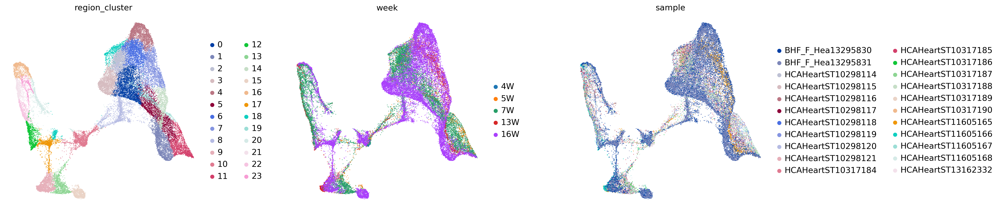

In [69]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['region_cluster','week','sample'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False)

In [ ]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['region_cluster'], groups=['14','6','4'],size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False)

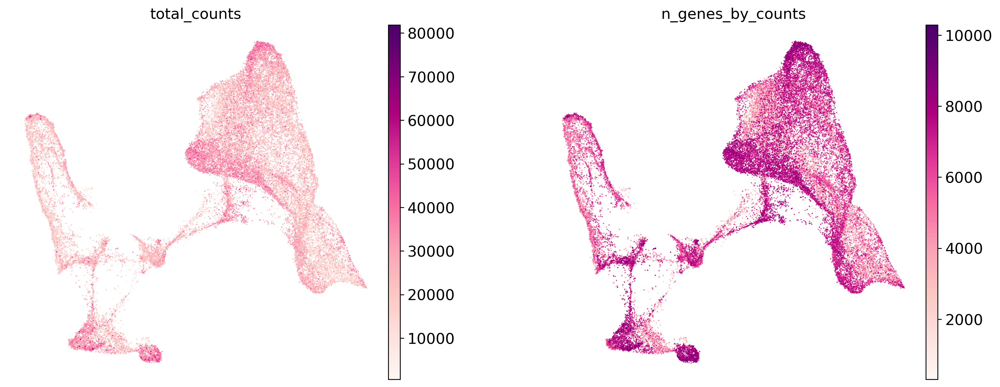

In [26]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['total_counts','n_genes_by_counts'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False)

In [ ]:
# manually annotated structures, plotting separately
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    
    fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(20,10))
    dotsize = 10
    
    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['Myocardium - Atrial',
                                                 'Myocardium - Papillary Muscle',
                                                 'Myocardium - Ventricular - Compact',
                                                 'Myocardium - Ventricular - Trabeculated'],
               size=dotsize, title='Myocardium', legend_fontsize=10, frameon=False,
              show=False, ax=axs[0,0])

    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['Coronary artery','Great vessels',],
               size=dotsize, title='Vessels',legend_fontsize=10, frameon=False,
              show=False, ax=axs[0,1])
    
    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['AV ring','AV valves','Aortic valve','Valve apparatus'],
               size=dotsize, title='Valves + alpha', legend_fontsize=10, frameon=False,
              show=False, ax=axs[0,2])

    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['AVN','Bundle branch - left','Bundle branch - right'],
               size=dotsize, title='CCSs', legend_fontsize=10, frameon=False,
              show=False, ax=axs[1,0])

    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['Epicardium'],
               size=dotsize, title='Epicardium', legend_fontsize=10, frameon=False,
              show=False, ax=axs[1,1])
    
    sc.pl.umap(adata_vis, color=['JC_edit'], groups=['LN'],
               size=dotsize, title='LN', legend_fontsize=10, frameon=False,
              show=False, ax=axs[1,2])
    plt.tight_layout()

# Plot cell abundances

In [16]:
# prepare cell2location anndata
cellnames = adata_vis.obsm['q05_cell_abundance_w_sf'].columns
cellnames = [x.split('q05cell_abundance_w_sf_')[1] for x in cellnames]
adata_c2l = anndata.AnnData(
    X=adata_vis.obsm['q05_cell_abundance_w_sf_ndarray'].copy(),
    obs=adata_vis.obs.copy(),
    var=pd.DataFrame(cellnames).set_index(0),
    obsm=adata_vis.obsm.copy(),
    obsp=adata_vis.obsp.copy(),
    uns=adata_vis.uns.copy()
)
adata_c2l

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/ipykernel_launcher.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  # Remove the CWD from sys.path while we load stuff.


AnnData object with n_obs × n_vars = 39223 × 58
    obs: 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sangerID', 'Publication', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'status', 'cell2loc-map_group', 'JC_edit', 'sample_for_cell2loc', 'week', 'leiden', 'region_cluster'
    uns: 'JC_edit_colors', 'cell2loc-map_group_colors', 'leiden', 'neighbors', 'region_cluster_colors', 'sample_for_cell2loc_colors', 'umap', 'log1p', 'week_colors'
    obsm: 'MT', 'X_umap', 'means_cell_abundance_w_sf', 'q05_cell_abundance_w_sf', 'q05_cell_abundance_w_sf_ndarray', 'q95_cell_abundance_w_sf', 'spatial', 'stds_cell_abundance_w_sf'
    obsp: 'connectivities', 'distances'

In [70]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_c2l, color=cellnames, size=20,
               color_map = 'RdPu', ncols = 4, wspace=0.1, vmax='p99.98',
               legend_fontsize=14, frameon=False)

# Plot clusters on visium sections

In [38]:
# need to read in each object to plot visium section...(as far as i know)

adata_oct = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-OCT_foetal_raw.h5ad')

adata_da = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-OCT_foetal_DuctusA_raw.h5ad')
adata_da.obs['sample_for_cell2loc'] = adata_da.obs['sample'].copy()

adata_ffpe = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-FFPE_foetal_raw.h5ad')
adata_ffpe.obs['sample_for_cell2loc'] = adata_ffpe.obs['sample'].copy()
adata_ffpe.obs['cell2loc-map_group'] = 'FFPE_16PCW'
adata_ffpe = adata_ffpe[adata_ffpe.obs['JC_edit'].isin(['Cavity'])==False]

In [39]:
# set color
## for clusters
palette1={}
for i,annot in enumerate(adata_vis.obs['region_cluster'].cat.categories):
    palette1[annot]=adata_vis.uns['region_cluster_colors'][i]

## for JC_edit
colormap='tab20'
palette2={}
for i,annot in enumerate(adata_vis.obs['JC_edit'].cat.categories):
    palette2[annot]=plt.get_cmap(colormap).colors[i]

### FFPE

In [ ]:
adata_ffpe.obs['region_cluster'] = adata_vis.obs['region_cluster'].reindex(adata_ffpe.obs_names)
slides_to_plot = list(set(adata_ffpe.obs['sample']))

for s in slides_to_plot:
    slide = select_multislide(adata_ffpe, [s])
    with mpl.rc_context({'figure.figsize': [4.5, 4],
                        'axes.titlesize':20,}):
        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15,5))

        sc.pl.spatial(slide,
                      color=['region_cluster'], 
                      size=1.2,img_key='hires',alpha_img=0.3, palette=palette1,
                      show=False, ax=axs[0],title = f'region_cluster, {s}'
                     )
        sc.pl.spatial(slide,
                      color=['JC_edit'], 
                      size=1.2,img_key='hires',alpha_img=0.3, palette=palette2,
                      show=False, ax=axs[1], title = f'JC_edit, {s}'
                     )
        plt.tight_layout()

In [ ]:
slide = select_multislide(adata_ffpe, ['BHF_F_Hea13295831'])

with mpl.rc_context({'figure.figsize': [4.5, 4],
                    'axes.titlesize':20,}):

    fig, axs = plt.subplots(nrows=4, ncols=6, figsize=(20,15))
    for i,g in enumerate(adata_vis.obs['region_cluster'].cat.categories):
        sc.pl.spatial(slide,
                      color=['region_cluster'], groups=g,
                      size=1.2,img_key='hires',alpha_img=0.1, palette=palette1,
                      show=False, ax=axs[i//6,i%6]
                     )
    plt.tight_layout()

### OCT

In [ ]:
adata_oct.obs['region_cluster'] = adata_vis.obs['region_cluster'].reindex(adata_oct.obs_names)
slides_to_plot = list(set(adata_oct.obs['sample']))
slides_to_plot.sort()

for s in slides_to_plot:
    slide = select_multislide(adata_oct, [s])
    with mpl.rc_context({'figure.figsize': [4.5, 4],
                        'axes.titlesize':20,}):

        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15,5))

        sc.pl.spatial(slide,
                      color=['region_cluster'], 
                      size=1.2,img_key='hires',alpha_img=0.3, palette=palette1,
                      show=False, ax=axs[0], title = f'region_cluster, {s}'
                     )
        sc.pl.spatial(slide,
                      color=['JC_edit'], 
                      size=1.2,img_key='hires',alpha_img=0.3, palette=palette2,
                      show=False, ax=axs[1], title = f'JC_edit, {s}'
                     )
        plt.tight_layout()

In [ ]:
slide = select_multislide(adata_oct, ['HCAHeartST11605165'])

with mpl.rc_context({'figure.figsize': [4.5, 4],
                    'axes.titlesize':20,}):

    fig, axs = plt.subplots(nrows=4, ncols=6, figsize=(20,15))
    for i,g in enumerate(adata_vis.obs['region_cluster'].cat.categories):
        sc.pl.spatial(slide,
                      color=['region_cluster'], groups=g,
                      size=1.2,img_key='hires',alpha_img=0.1, palette=palette1,
                      show=False, ax=axs[i//6,i%6]
                     )
    plt.tight_layout()

# DotPlot

         Falling back to preprocessing with `sc.pp.pca` and default params.


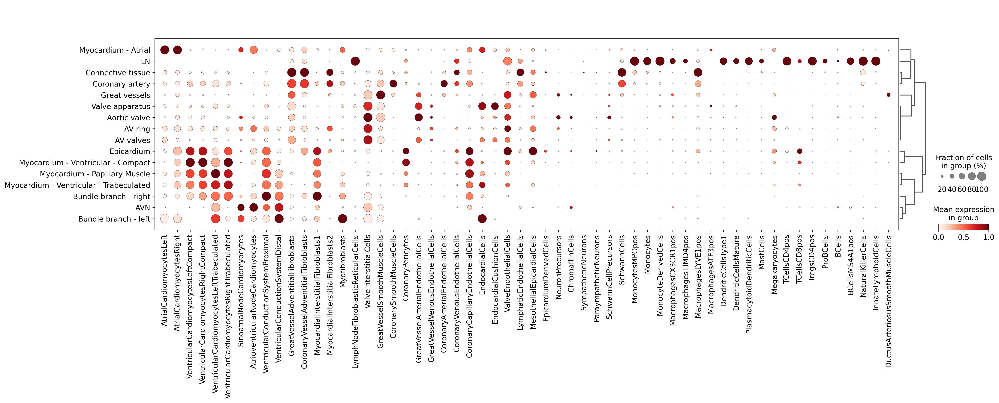

In [19]:
sc.pl.dotplot(adata_c2l,
              adata_c2l.var_names, 
              groupby='JC_edit',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

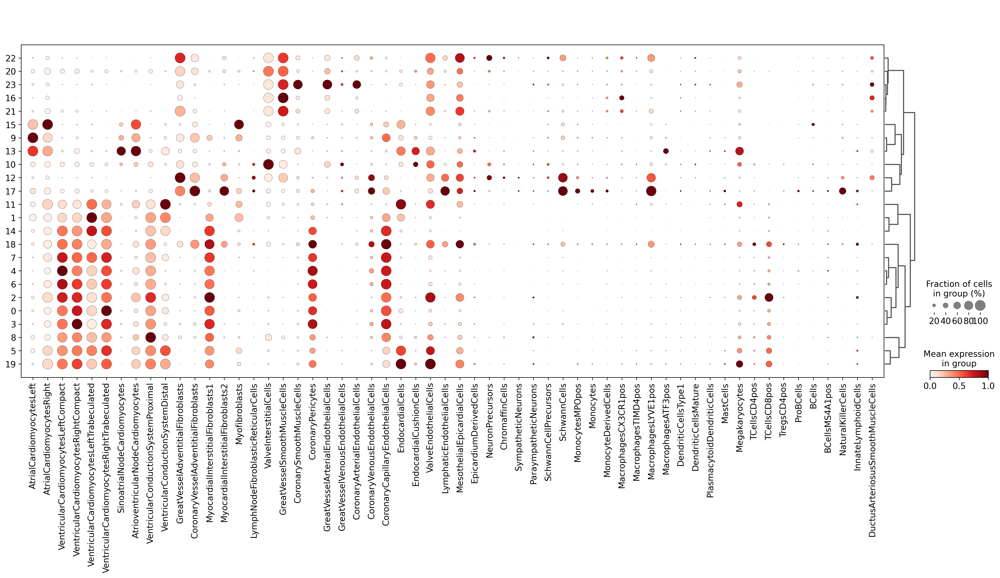

In [20]:
sc.pl.dotplot(adata_c2l,
              adata_c2l.var_names, 
              groupby='region_cluster',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

# DA test

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perfo

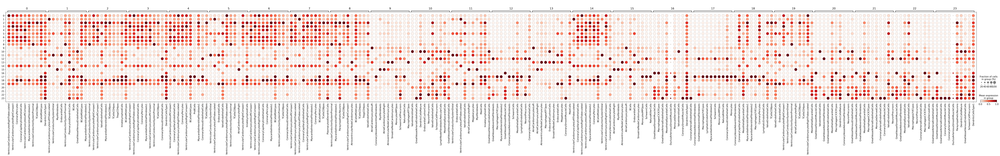

In [43]:
sc.tl.rank_genes_groups(adata_c2l,
                       groupby='region_cluster')
sc.pl.rank_genes_groups_dotplot(adata_c2l,
                               standard_scale='var',
                               dendrogram=False)